In [1]:
import os
import pandas as pd

pdb_sugar_files = os.listdir("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/pdb_EM_sugars")
colvar_files = os.listdir("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/colvar_EM_sugars")

sugar_files_df = pd.DataFrame({"sugar_file_names": pdb_sugar_files})
colvar_files_df = pd.DataFrame({"colvar_file_names": colvar_files})

In [2]:
#Tira os arquivos de backup

# Filtrar e excluir os valores que começam com "bck"
nobck_colvar_df = colvar_files_df[~colvar_files_df['colvar_file_names'].str.startswith('bck')]

In [3]:
# Filtrar nobck_colvar_df para manter somente os valores que são substrings dos valores de sugar_files_df
def is_substring_in_any(value, substrings):
    return any(value in substring for substring in substrings)

# Aplicar a função para filtrar as linhas
filtered_df = nobck_colvar_df[nobck_colvar_df['colvar_file_names'].apply(lambda x: is_substring_in_any(x, sugar_files_df['sugar_file_names']))]

In [6]:
#Extrair dados colvar
from tqdm import tqdm

# Criar os DataFrames vazios com as colunas especificadas
piranose_df = pd.DataFrame(columns=['sugar', 'time', 'puck.qx', 'puck.qy', 'puck.qz', 'puck.phi', 'puck.theta', 'puck.amplitude'])

furanose_df = pd.DataFrame(columns=['sugar', 'time', 'puck.phs', 'puck.amp', 'puck.Zx', 'puck.Zy'])

# Caminho para o arquivo .colvar
#file_path = "/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/colvar/6zho_GLC_4663"

def read_colvar(file_path):
    global piranose_df
    global furanose_df

    # Abrir o arquivo e ler as linhas
    with open(file_path, 'r') as file:
        lines = file.readlines()

    # Encontrar a linha com os nomes das colunas (depois de "#! FIELDS")
    fields_line = next(line for line in lines if line.startswith('#! FIELDS'))

    # Extrair nomes das colunas (remover "#! FIELDS " e dividir os nomes das colunas)
    column_names = fields_line.strip().lstrip('#! FIELDS').strip().split()

    # Ler o restante do arquivo usando pandas
    data = pd.read_csv(file_path, delim_whitespace=True, comment='#', header=None, skiprows=1, names=column_names)

    data['sugar'] = file_path.split('colvar/', 1)[-1]

    # Reordenar as colunas para colocar 'sugar' como a primeira
    cols = ['sugar'] + [col for col in data.columns if col != 'sugar']
    data = data[cols]

    # Adicionar no DF geral
    if(len(data.columns) == 8):
        #Piranoses
        piranose_df = pd.concat([piranose_df, data], ignore_index=True)
    elif(len(data.columns) == 6):
        #Furanoses
        furanose_df = pd.concat([furanose_df, data], ignore_index=True)

# Iterar sobre os nomes dos arquivos e processá-los com uma barra de progresso
for file_name in tqdm(filtered_df['colvar_file_names']):
    read_colvar("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/colvar_EM_sugars/" + file_name)



  0%|          | 0/77253 [00:00<?, ?it/s]/tmp/ipykernel_1336569/3573196968.py:27: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(file_path, delim_whitespace=True, comment='#', header=None, skiprows=1, names=column_names)
/tmp/ipykernel_1336569/3573196968.py:38: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  piranose_df = pd.concat([piranose_df, data], ignore_index=True)
/tmp/ipykernel_1336569/3573196968.py:27: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(file_path, delim_whitespace=True, comment='#', header=None

In [9]:
#Tirar o caminho dos nomes
piranose_df['sugar'] = piranose_df['sugar'].str.split('sugars/').str[-1]
furanose_df['sugar'] = furanose_df['sugar'].str.split('sugars/').str[-1]

In [7]:
#Salvar antes de calcular os bfactors
piranose_df.to_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/EM_piranoses.csv")
furanose_df.to_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/EM_furanoses.csv")

In [10]:
#No duplicates
piranose_df = piranose_df.drop_duplicates()

In [11]:
#To degrees
import numpy as np

piranose_df['puck.phi_graus'] = np.degrees(piranose_df['puck.phi'])
piranose_df['puck.theta_graus'] = np.degrees(piranose_df['puck.theta'])


#TO .colvar_files

piranose_df.to_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/EM_piranoses_degrees.csv")


In [53]:
#READ
import pandas as pd
piranose_df = pd.read_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/EM_piranoses_degrees.csv", 
                        names = ['sugar', 'time', 'puck.qx', 'puck.qy', 'puck.qz', 'puck.phi', 'puck.theta', 'puck.amplitude', 'puck.phi_graus', 'puck.theta_graus'])

/tmp/ipykernel_3160051/1565497228.py:3: DtypeWarning: Columns (2,3,4,5,6,7,8,9,10) have mixed types. Specify dtype option on import or set low_memory=False.
  piranose_df = pd.read_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/EM_piranoses_degrees.csv",


/home/douglas/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


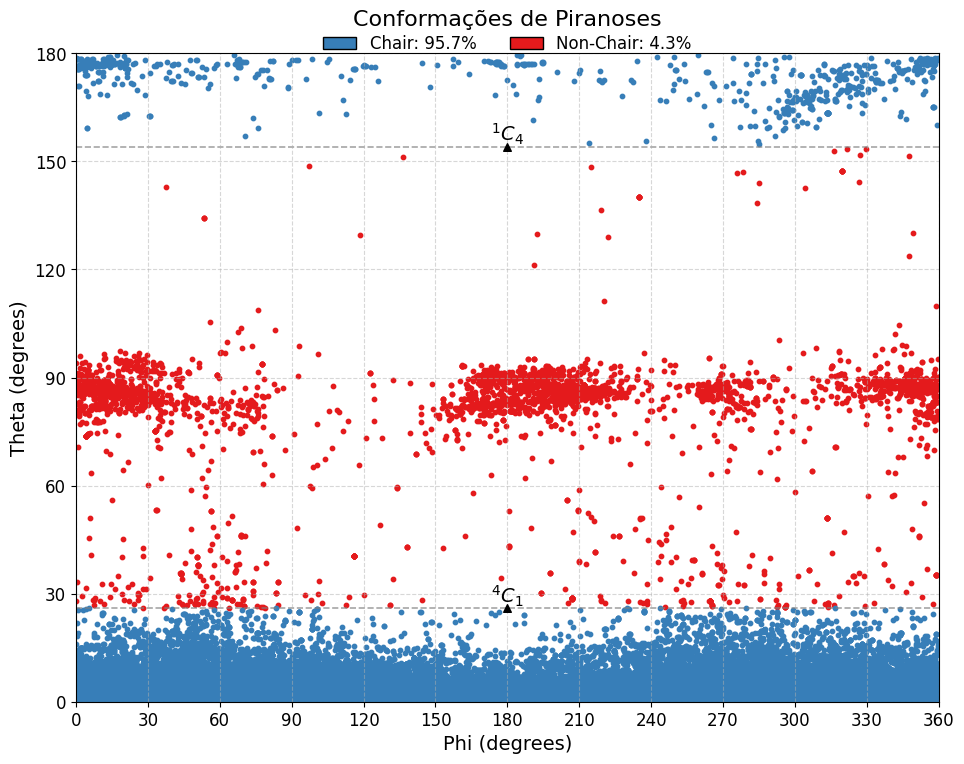

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# Converter as colunas 'puck.theta_graus' e 'puck.phi_graus' para numéricas
piranose_df['puck.theta_graus'] = pd.to_numeric(piranose_df['puck.theta_graus'], errors='coerce')
piranose_df['puck.phi_graus'] = pd.to_numeric(piranose_df['puck.phi_graus'], errors='coerce')

# Verificar se piranose_df está carregado
try:
    piranose_df
except NameError:
    raise NameError("O DataFrame 'piranose_df' não foi definido. Por favor, carregue-o antes de executar o código.")

# Coordenadas e labels
coordinates = [
    (180, 26, r"$^{4}C_{1}$"),
    (180, 154, r"$^{1}C_{4}$")
]

# Cores para os pontos
default_color = '#377eb8'  # Azul (Chair)
highlight_color = '#e41a1c'  # Vermelho (Non-Chair)

# Criar uma figura única
fig, ax = plt.subplots(figsize=(10, 8))

# Filtrar os dados do DataFrame
highlight_condition = (piranose_df['puck.theta_graus'] > 26) & (piranose_df['puck.theta_graus'] < 154)

# Pontos destacados (Non-Chair)
ax.scatter(
    piranose_df.loc[highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[highlight_condition, 'puck.theta_graus'], 
    color=highlight_color,  # Vermelho
    s=10,  # Tamanho dos pontos (aumentado para melhor visualização)
    label='Non-Chair'
)

# Pontos padrão (Chair)
ax.scatter(
    piranose_df.loc[~highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[~highlight_condition, 'puck.theta_graus'], 
    color=default_color,  # Azul
    s=10,  # Tamanho dos pontos
    label='Chair'
)

# Adicionar as coordenadas específicas com rótulos
for x, y, label in coordinates:
    ax.axhline(
        y=y, 
        color='gray', 
        linestyle='--', 
        linewidth=1.2, 
        alpha=0.7, 
        zorder=1
    )  # Linha horizontal
    ax.scatter(x, y, color='black', s=30, marker='^', zorder=10)  # Ponto marcado
    ax.text(
        x, y, 
        label,
        fontsize=14,  # Aumentar o tamanho da fonte
        ha='center',
        va='bottom',
        color='black',
        zorder=10
    )

# Configurações do gráfico
ax.set_xlim([0, 360])  # Limites do eixo x
ax.set_ylim([0, 180])  # Limites do eixo y
ax.set_xlabel('Phi (degrees)', fontsize=14)  # Rótulo do eixo x
ax.set_ylabel('Theta (degrees)', fontsize=14)  # Rótulo do eixo y
ax.set_title('Conformações de Piranoses', fontsize=16, pad=20)  # Título com maior espaçamento

# Definir os valores dos eixos com intervalo de 30
ax.set_xticks(range(0, 361, 30))  # Eixo x de 0 a 360 com intervalo de 30
ax.set_yticks(range(0, 181, 30))  # Eixo y de 0 a 180 com intervalo de 30
ax.tick_params(axis='both', labelsize=12)  # Ajustar tamanho das labels dos eixos
ax.grid(True, linestyle='--', alpha=0.5)  # Adicionar grade para melhor visualização

# Cálculo das porcentagens
total_points = len(piranose_df)
chair_points = len(piranose_df.loc[~highlight_condition])
non_chair_points = len(piranose_df.loc[highlight_condition])

chair_percentage = (chair_points / total_points) * 100
non_chair_percentage = (non_chair_points / total_points) * 100

# Adicionar a legenda no topo central
legend_elements = [
    Patch(facecolor=default_color, edgecolor='black', label=f'Chair: {chair_percentage:.1f}%'),
    Patch(facecolor=highlight_color, edgecolor='black', label=f'Non-Chair: {non_chair_percentage:.1f}%')
]
ax.legend(
    handles=legend_elements,
    loc='upper center',
    bbox_to_anchor=(0.5, 1.052),
    fontsize=12,
    frameon=False,
    ncol=2  # Organiza a legenda em duas colunas
)

plt.tight_layout(pad=2.0)  # Ajuste de padding para evitar sobreposição
plt.show()


In [54]:
# .dat
import pandas as pd
import numpy as np
names = ['puck.theta', 'puck.phi', 'file.free', 'der_puck.theta', 'der_puck.phi']
manose_dat = pd.read_csv('/home/douglas/carboanalysis/carboanalysis/pdb/dinamicas/fes-manose.dat', delim_whitespace=True, header=None, skiprows=9, names = names)

#To degrees
manose_dat['puck.phi_graus'] = np.degrees(manose_dat['puck.phi'])
manose_dat['puck.theta_graus'] = np.degrees(manose_dat['puck.theta'])

#Select columns

manose_dat = manose_dat[['puck.phi_graus', 'puck.theta_graus', 'file.free']]

/tmp/ipykernel_3160051/3462303192.py:5: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  manose_dat = pd.read_csv('/home/douglas/carboanalysis/carboanalysis/pdb/dinamicas/fes-manose.dat', delim_whitespace=True, header=None, skiprows=9, names = names)


In [56]:
#Only select manose

piranose_df = piranose_df[piranose_df['sugar'].str.contains('MAN|BMA', na=False)]

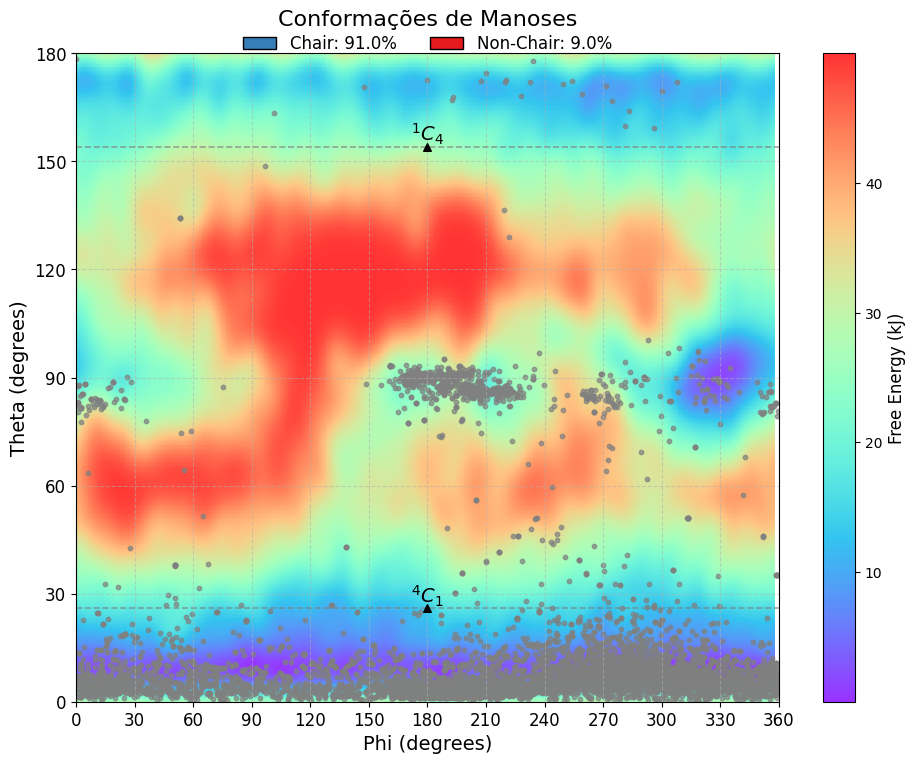

In [59]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from scipy.interpolate import griddata

# Converter colunas de manose_dat para numéricas (caso necessário)
manose_dat['puck.theta_graus'] = pd.to_numeric(manose_dat['puck.theta_graus'], errors='coerce')
manose_dat['puck.phi_graus'] = pd.to_numeric(manose_dat['puck.phi_graus'], errors='coerce')
manose_dat['file.free'] = pd.to_numeric(manose_dat['file.free'], errors='coerce')

# Remover linhas com valores inválidos
manose_dat = manose_dat.dropna(subset=['puck.theta_graus', 'puck.phi_graus', 'file.free'])

# Criar uma grade para o fundo
x = manose_dat['puck.phi_graus']
y = manose_dat['puck.theta_graus']
z = manose_dat['file.free']

# Definir os limites e criar a malha
xi = np.linspace(0, 360, 500)  # Resolução no eixo X
yi = np.linspace(0, 180, 500)  # Resolução no eixo Y
xi, yi = np.meshgrid(xi, yi)

# Interpolação para preencher os valores da grade
zi = griddata((x, y), z, (xi, yi), method='linear')

# Criar a figura
fig, ax = plt.subplots(figsize=(10, 8))

# Adicionar o fundo colorido contínuo
cmap = plt.cm.rainbow  # Escolha um colormap, pode ser 'viridis', 'coolwarm', etc.
im = ax.pcolormesh(xi, yi, zi, shading='auto', cmap=cmap, alpha=0.8)

# Adicionar a barra de cores para referência
cbar = plt.colorbar(im, ax=ax)
cbar.set_label('Free Energy (kJ)', fontsize=12)

# Adicionar os dados do gráfico principal (os pontos)
highlight_condition = (piranose_df['puck.theta_graus'] > 26) & (piranose_df['puck.theta_graus'] < 154)

# Pontos destacados (Non-Chair)
ax.scatter(
    piranose_df.loc[highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[highlight_condition, 'puck.theta_graus'], 
    color='#808080',  # Vermelho
    s=10,
    label='Non-Chair',
    alpha = 0.7
)

# Pontos padrão (Chair)
ax.scatter(
    piranose_df.loc[~highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[~highlight_condition, 'puck.theta_graus'], 
    color='#808080',  # Azul
    s=10,
    label='Chair',
    alpha = 0.7
)

# Adicionar coordenadas e rótulos
coordinates = [(180, 26, r"$^{4}C_{1}$"), (180, 154, r"$^{1}C_{4}$")]
for x, y, label in coordinates:
    ax.axhline(y=y, color='gray', linestyle='--', linewidth=1.2, alpha=0.7, zorder=1)
    ax.scatter(x, y, color='black', s=30, marker='^', zorder=10)
    ax.text(x, y, label, fontsize=14, ha='center', va='bottom', color='black', zorder=10)

# Configurações do gráfico
ax.set_xlim([0, 360])
ax.set_ylim([0, 180])
ax.set_xlabel('Phi (degrees)', fontsize=14)
ax.set_ylabel('Theta (degrees)', fontsize=14)
ax.set_title('Conformações de Manoses', fontsize=16, pad=20)
ax.set_xticks(range(0, 361, 30))
ax.set_yticks(range(0, 181, 30))
ax.tick_params(axis='both', labelsize=12)
ax.grid(True, linestyle='--', alpha=0.5)

# Adicionar a legenda
chair_percentage = len(piranose_df.loc[~highlight_condition]) / len(piranose_df) * 100
non_chair_percentage = len(piranose_df.loc[highlight_condition]) / len(piranose_df) * 100
legend_elements = [
    Patch(facecolor='#377eb8', edgecolor='black', label=f'Chair: {chair_percentage:.1f}%'),
    Patch(facecolor='#e41a1c', edgecolor='black', label=f'Non-Chair: {non_chair_percentage:.1f}%')
]
ax.legend(
    handles=legend_elements,
    loc='upper center',
    bbox_to_anchor=(0.5, 1.052),
    fontsize=12,
    frameon=False,
    ncol=2
)

plt.tight_layout(pad=2.0)
plt.show()


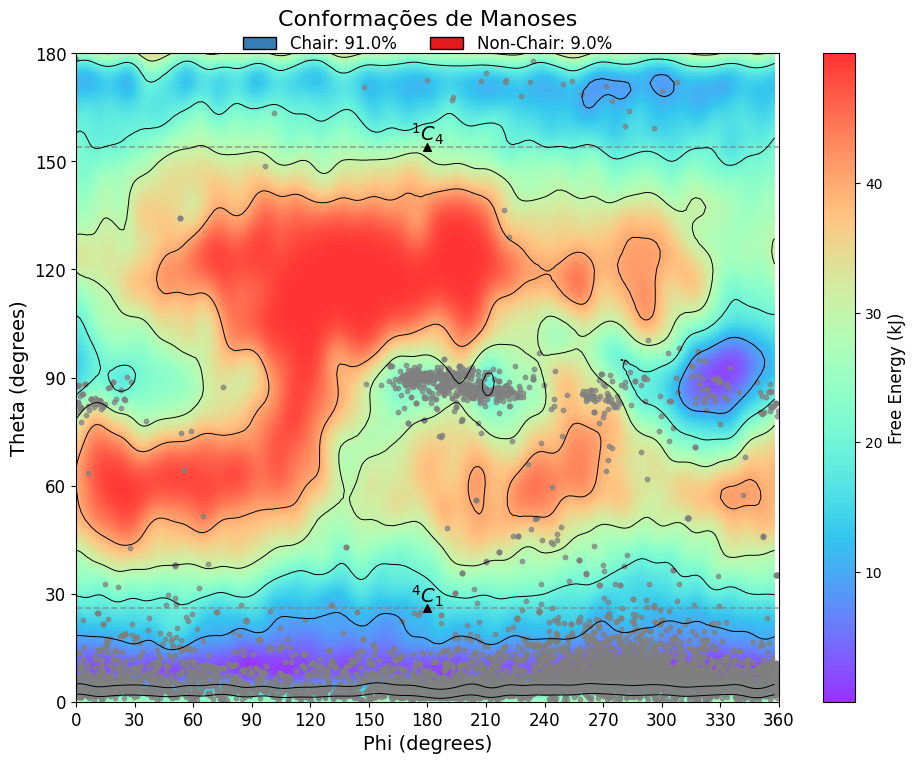

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from scipy.interpolate import griddata

# Converter colunas de manose_dat para numéricas (caso necessário)
manose_dat['puck.theta_graus'] = pd.to_numeric(manose_dat['puck.theta_graus'], errors='coerce')
manose_dat['puck.phi_graus'] = pd.to_numeric(manose_dat['puck.phi_graus'], errors='coerce')
manose_dat['file.free'] = pd.to_numeric(manose_dat['file.free'], errors='coerce')

# Remover linhas com valores inválidos
manose_dat = manose_dat.dropna(subset=['puck.theta_graus', 'puck.phi_graus', 'file.free'])

# Criar uma grade para o fundo
x = manose_dat['puck.phi_graus']
y = manose_dat['puck.theta_graus']
z = manose_dat['file.free']

# Definir os limites e criar a malha
xi = np.linspace(0, 360, 500)  # Resolução no eixo X
yi = np.linspace(0, 180, 500)  # Resolução no eixo Y
xi, yi = np.meshgrid(xi, yi)

# Interpolação para preencher os valores da grade
zi = griddata((x, y), z, (xi, yi), method='linear')

# Criar a figura
fig, ax = plt.subplots(figsize=(10, 8))

# Adicionar o fundo colorido contínuo
cmap = plt.cm.rainbow  # Escolha um colormap, pode ser 'viridis', 'coolwarm', etc.
im = ax.pcolormesh(xi, yi, zi, shading='auto', cmap=cmap, alpha=0.8)

# Adicionar a barra de cores para referência
cbar = plt.colorbar(im, ax=ax)
cbar.set_label('Free Energy (kJ)', fontsize=12)

# Adicionar contornos a cada 10 kJ
contour_levels = np.arange(10, np.nanmax(zi), 10)  # Intervalos de 10 kJ, ignorando NaNs
ax.contour(xi, yi, zi, levels=contour_levels, colors='black', linewidths=0.7)

# Adicionar os dados do gráfico principal (os pontos)
highlight_condition = (piranose_df['puck.theta_graus'] > 26) & (piranose_df['puck.theta_graus'] < 154)

# Pontos destacados (Non-Chair)
ax.scatter(
    piranose_df.loc[highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[highlight_condition, 'puck.theta_graus'], 
    color='#808080',  # Cor dos pontos destacados
    s=10,
    label='Non-Chair',
    alpha=0.7
)

# Pontos padrão (Chair)
ax.scatter(
    piranose_df.loc[~highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[~highlight_condition, 'puck.theta_graus'], 
    color='#808080',  # Cor dos pontos padrão
    s=10,
    label='Chair',
    alpha=0.7
)

# Adicionar coordenadas e rótulos
coordinates = [(180, 26, r"$^{4}C_{1}$"),
                (180, 154, r"$^{1}C_{4}$")]

for x, y, label in coordinates:
    ax.axhline(y=y, color='gray', linestyle='--', linewidth=1.2, alpha=0.7, zorder=1)
    ax.scatter(x, y, color='black', s=30, marker='^', zorder=10)
    ax.text(x, y, label, fontsize=14, ha='center', va='bottom', color='black', zorder=10)

# Configurações do gráfico
ax.set_xlim([0, 360])
ax.set_ylim([0, 180])
ax.set_xlabel('Phi (degrees)', fontsize=14)
ax.set_ylabel('Theta (degrees)', fontsize=14)
ax.set_title('Conformações de Manoses', fontsize=16, pad=20)
ax.set_xticks(range(0, 361, 30))
ax.set_yticks(range(0, 181, 30))
ax.tick_params(axis='both', labelsize=12)

# Remover a grade
ax.grid(False)

# Adicionar a legenda
chair_percentage = len(piranose_df.loc[~highlight_condition]) / len(piranose_df) * 100
non_chair_percentage = len(piranose_df.loc[highlight_condition]) / len(piranose_df) * 100
legend_elements = [
    Patch(facecolor='#377eb8', edgecolor='black', label=f'Chair: {chair_percentage:.1f}%'),
    Patch(facecolor='#e41a1c', edgecolor='black', label=f'Non-Chair: {non_chair_percentage:.1f}%')
]
ax.legend(
    handles=legend_elements,
    loc='upper center',
    bbox_to_anchor=(0.5, 1.052),
    fontsize=12,
    frameon=False,
    ncol=2
)

plt.tight_layout(pad=2.0)
plt.show()


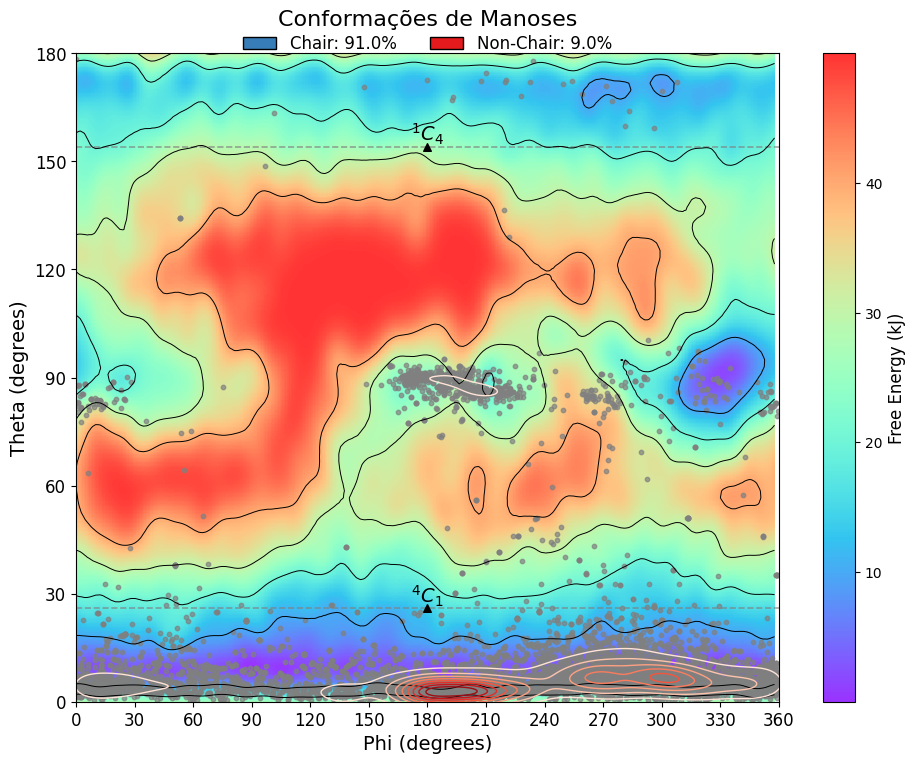

In [61]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from scipy.interpolate import griddata
from scipy.stats import gaussian_kde

# Converter colunas de manose_dat para numéricas (caso necessário)
manose_dat['puck.theta_graus'] = pd.to_numeric(manose_dat['puck.theta_graus'], errors='coerce')
manose_dat['puck.phi_graus'] = pd.to_numeric(manose_dat['puck.phi_graus'], errors='coerce')
manose_dat['file.free'] = pd.to_numeric(manose_dat['file.free'], errors='coerce')

# Remover linhas com valores inválidos
manose_dat = manose_dat.dropna(subset=['puck.theta_graus', 'puck.phi_graus', 'file.free'])

# Criar uma grade para o fundo
x = manose_dat['puck.phi_graus']
y = manose_dat['puck.theta_graus']
z = manose_dat['file.free']

# Definir os limites e criar a malha
xi = np.linspace(0, 360, 500)  # Resolução no eixo X
yi = np.linspace(0, 180, 500)  # Resolução no eixo Y
xi, yi = np.meshgrid(xi, yi)

# Interpolação para preencher os valores da grade
zi = griddata((x, y), z, (xi, yi), method='linear')

# Criar a figura
fig, ax = plt.subplots(figsize=(10, 8))

# Adicionar o fundo colorido contínuo
cmap = plt.cm.rainbow  # Escolha um colormap, pode ser 'viridis', 'coolwarm', etc.
im = ax.pcolormesh(xi, yi, zi, shading='auto', cmap=cmap, alpha=0.8)

# Adicionar a barra de cores para referência
cbar = plt.colorbar(im, ax=ax)
cbar.set_label('Free Energy (kJ)', fontsize=12)

# Adicionar contornos a cada 10 kJ
contour_levels = np.arange(10, np.nanmax(zi), 10)  # Intervalos de 10 kJ, ignorando NaNs
ax.contour(xi, yi, zi, levels=contour_levels, colors='black', linewidths=0.7)

# Adicionar os dados do gráfico principal (os pontos)
highlight_condition = (piranose_df['puck.theta_graus'] > 26) & (piranose_df['puck.theta_graus'] < 154)

# Pontos destacados (Non-Chair)
ax.scatter(
    piranose_df.loc[highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[highlight_condition, 'puck.theta_graus'], 
    color='#808080',  # Cor dos pontos destacados
    s=10,
    label='Non-Chair',
    alpha=0.7
)

# Pontos padrão (Chair)
ax.scatter(
    piranose_df.loc[~highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[~highlight_condition, 'puck.theta_graus'], 
    color='#808080',  # Cor dos pontos padrão
    s=10,
    label='Chair',
    alpha=0.7
)

# Calcular a densidade de pontos
data = np.vstack([piranose_df['puck.phi_graus'], piranose_df['puck.theta_graus']])
kde = gaussian_kde(data, bw_method=0.1)  # Ajuste o parâmetro bw_method para controlar a suavização
xmin, xmax = ax.get_xlim()
ymin, ymax = ax.get_ylim()

# Gerar uma grade de valores para estimar a densidade
x_grid, y_grid = np.meshgrid(np.linspace(xmin, xmax, 500), np.linspace(ymin, ymax, 500))
grid_coords = np.vstack([x_grid.ravel(), y_grid.ravel()])
density = kde(grid_coords).reshape(x_grid.shape)

# Contornos de densidade
ax.contour(x_grid, y_grid, density, levels=np.linspace(density.min(), density.max(), 10), cmap='Reds', linewidths=1)

# Adicionar coordenadas e rótulos
coordinates = [(180, 26, r"$^{4}C_{1}$"), (180, 154, r"$^{1}C_{4}$")]
for x, y, label in coordinates:
    ax.axhline(y=y, color='gray', linestyle='--', linewidth=1.2, alpha=0.7, zorder=1)
    ax.scatter(x, y, color='black', s=30, marker='^', zorder=10)
    ax.text(x, y, label, fontsize=14, ha='center', va='bottom', color='black', zorder=10)

# Configurações do gráfico
ax.set_xlim([0, 360])
ax.set_ylim([0, 180])
ax.set_xlabel('Phi (degrees)', fontsize=14)
ax.set_ylabel('Theta (degrees)', fontsize=14)
ax.set_title('Conformações de Manoses', fontsize=16, pad=20)
ax.set_xticks(range(0, 361, 30))
ax.set_yticks(range(0, 181, 30))
ax.tick_params(axis='both', labelsize=12)

# Remover a grade
ax.grid(False)

# Adicionar a legenda
chair_percentage = len(piranose_df.loc[~highlight_condition]) / len(piranose_df) * 100
non_chair_percentage = len(piranose_df.loc[highlight_condition]) / len(piranose_df) * 100
legend_elements = [
    Patch(facecolor='#377eb8', edgecolor='black', label=f'Chair: {chair_percentage:.1f}%'),
    Patch(facecolor='#e41a1c', edgecolor='black', label=f'Non-Chair: {non_chair_percentage:.1f}%')
]
ax.legend(
    handles=legend_elements,
    loc='upper center',
    bbox_to_anchor=(0.5, 1.052),
    fontsize=12,
    frameon=False,
    ncol=2
)

plt.tight_layout(pad=2.0)
plt.show()


In [43]:
# .dat
import pandas as pd
import numpy as np
names = ['puck.theta', 'puck.phi', 'file.free', 'der_puck.theta', 'der_puck.phi']
glicose_dat = pd.read_csv('/home/douglas/carboanalysis/carboanalysis/pdb/dinamicas/fes-glicose.dat', delim_whitespace=True, header=None, skiprows=9, names = names)

#To degrees
glicose_dat['puck.phi_graus'] = np.degrees(glicose_dat['puck.phi'])
glicose_dat['puck.theta_graus'] = np.degrees(glicose_dat['puck.theta'])

#Select columns

glicose_dat = glicose_dat[['puck.phi_graus', 'puck.theta_graus', 'file.free']]

/tmp/ipykernel_3160051/1756898958.py:5: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  glicose_dat = pd.read_csv('/home/douglas/carboanalysis/carboanalysis/pdb/dinamicas/fes-glicose.dat', delim_whitespace=True, header=None, skiprows=9, names = names)


In [44]:
#Select glicose

piranose_df = piranose_df[piranose_df['sugar'].str.contains('GLC|BGC', na=False)]

TypeError: '>' not supported between instances of 'str' and 'int'

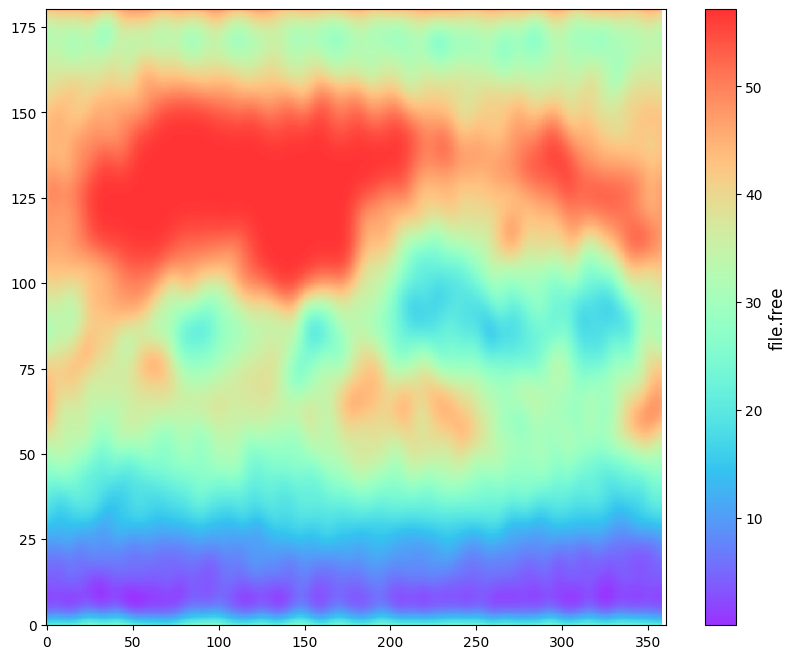

In [51]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from scipy.interpolate import griddata

# Converter colunas de glicose_dat para numéricas (caso necessário)
glicose_dat['puck.theta_graus'] = pd.to_numeric(glicose_dat['puck.theta_graus'], errors='coerce')
glicose_dat['puck.phi_graus'] = pd.to_numeric(glicose_dat['puck.phi_graus'], errors='coerce')
glicose_dat['file.free'] = pd.to_numeric(glicose_dat['file.free'], errors='coerce')

# Remover linhas com valores inválidos
glicose_dat = glicose_dat.dropna(subset=['puck.theta_graus', 'puck.phi_graus', 'file.free'])

# Criar uma grade para o fundo
x = glicose_dat['puck.phi_graus']
y = glicose_dat['puck.theta_graus']
z = glicose_dat['file.free']

# Definir os limites e criar a malha
xi = np.linspace(0, 360, 500)  # Resolução no eixo X
yi = np.linspace(0, 180, 500)  # Resolução no eixo Y
xi, yi = np.meshgrid(xi, yi)

# Interpolação para preencher os valores da grade
zi = griddata((x, y), z, (xi, yi), method='linear')

# Criar a figura
fig, ax = plt.subplots(figsize=(10, 8))

# Adicionar o fundo colorido contínuo
cmap = plt.cm.rainbow  # Escolha um colormap, pode ser 'viridis', 'coolwarm', etc.
im = ax.pcolormesh(xi, yi, zi, shading='auto', cmap=cmap, alpha=0.8)

# Adicionar a barra de cores para referência
cbar = plt.colorbar(im, ax=ax)
cbar.set_label('file.free', fontsize=12)

# Adicionar os dados do gráfico principal (os pontos)
highlight_condition = (piranose_df['puck.theta_graus'] > 26) & (piranose_df['puck.theta_graus'] < 154)

# Pontos destacados (Non-Chair)
ax.scatter(
    piranose_df.loc[highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[highlight_condition, 'puck.theta_graus'], 
    color='#808080',  # Vermelho
    s=10,
    label='Non-Chair',
    alpha = 0.7
)

# Pontos padrão (Chair)
ax.scatter(
    piranose_df.loc[~highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[~highlight_condition, 'puck.theta_graus'], 
    color='#808080',  # Azul
    s=10,
    label='Chair',
    alpha = 0.7
)

# Adicionar coordenadas e rótulos
coordinates = [(180, 26, r"$^{4}C_{1}$"), (180, 154, r"$^{1}C_{4}$")]
for x, y, label in coordinates:
    ax.axhline(y=y, color='gray', linestyle='--', linewidth=1.2, alpha=0.7, zorder=1)
    ax.scatter(x, y, color='black', s=30, marker='^', zorder=10)
    ax.text(x, y, label, fontsize=14, ha='center', va='bottom', color='black', zorder=10)

# Configurações do gráfico
ax.set_xlim([0, 360])
ax.set_ylim([0, 180])
ax.set_xlabel('Phi (degrees)', fontsize=14)
ax.set_ylabel('Theta (degrees)', fontsize=14)
ax.set_title('Conformações de Manoses', fontsize=16, pad=20)
ax.set_xticks(range(0, 361, 30))
ax.set_yticks(range(0, 181, 30))
ax.tick_params(axis='both', labelsize=12)
ax.grid(True, linestyle='--', alpha=0.5)

# Adicionar a legenda
chair_percentage = len(piranose_df.loc[~highlight_condition]) / len(piranose_df) * 100
non_chair_percentage = len(piranose_df.loc[highlight_condition]) / len(piranose_df) * 100
legend_elements = [
    Patch(facecolor='#377eb8', edgecolor='black', label=f'Chair: {chair_percentage:.1f}%'),
    Patch(facecolor='#e41a1c', edgecolor='black', label=f'Non-Chair: {non_chair_percentage:.1f}%')
]
ax.legend(
    handles=legend_elements,
    loc='upper center',
    bbox_to_anchor=(0.5, 1.052),
    fontsize=12,
    frameon=False,
    ncol=2
)

plt.tight_layout(pad=2.0)
plt.show()

In [55]:
print(piranose_df[['puck.theta_graus', 'puck.phi_graus']].applymap(type))
piranose_df['puck.theta_graus'] = pd.to_numeric(piranose_df['puck.theta_graus'], errors='coerce')
piranose_df['puck.phi_graus'] = pd.to_numeric(piranose_df['puck.phi_graus'], errors='coerce')

# Remover linhas com NaN em 'puck.theta_graus' ou 'puck.phi_graus'
piranose_df = piranose_df.dropna(subset=['puck.theta_graus', 'puck.phi_graus'])
print(piranose_df.head())


        puck.theta_graus   puck.phi_graus
NaN        <class 'str'>    <class 'str'>
0.0        <class 'str'>    <class 'str'>
1.0        <class 'str'>    <class 'str'>
2.0        <class 'str'>    <class 'str'>
3.0        <class 'str'>    <class 'str'>
...                  ...              ...
77197.0  <class 'float'>  <class 'float'>
77198.0  <class 'float'>  <class 'float'>
77199.0  <class 'float'>  <class 'float'>
77200.0  <class 'float'>  <class 'float'>
77201.0  <class 'float'>  <class 'float'>

[77203 rows x 2 columns]
              sugar time    puck.qx    puck.qy   puck.qz  puck.phi puck.theta  \
0.0  6vkn_NAG_19773  0.0  -0.001434  -0.002326  0.060652  3.693862   0.045024   
1.0  6nc2_MAN_38383  0.0  -0.000572  -0.004659  0.056871  3.263798   0.082351   
2.0  7mly_NAG_20425  0.0  -0.003773   0.000349  0.057004  4.804667   0.066378   
3.0  7xix_NAG_26545  0.0   -6.8e-05   0.001047  0.056945  6.218364   0.018427   
4.0  7ls9_NAG_31600  0.0  -0.002208   0.001817  0.057679  5.40089

/tmp/ipykernel_3160051/2889807707.py:1: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  print(piranose_df[['puck.theta_graus', 'puck.phi_graus']].applymap(type))


In [5]:
######
# Separa os ht2 
######
method_df = pd.read_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/methods.txt", header=None, names = ['entry_filename', 'method'], sep=',')

em_sugars = method_df.loc[method_df['method'] == 'ELECTRON MICROSCOPY']['entry_filename'].values

res_filtered_df = pd.read_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/SIC/SIC2023_carbo_entrys_res_owab_filtered.txt", names = ['entry_filename'])
res_filtered_sugars = res_filtered_df['entry_filename'].values

all_sugars_df = pd.read_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/carbo_entrys_nd.txt", names = ['entry_filename'])
all_sugars = all_sugars_df['entry_filename'].values

# Transformar as listas em conjuntos
set_all_sugars = set(all_sugars)
set_res_filtered_sugars = set(res_filtered_sugars)
set_em_sugars = set(em_sugars)

# Calcular os valores de all_sugars que não estão nas outras listas
unique_sugars = set_all_sugars - (set_res_filtered_sugars | set_em_sugars)

# Transformar o resultado de volta em uma lista, se necessário
unique_sugars_list = list(unique_sugars)
